# The following will install the Detectron2 Dependencies

In [ ]:
# This will install the dependencies required for analyzing and training the dataset from roboflow (using cu101 because colab has CUDA 10.1).
!pip install -U torch==1.5 torchvision==0.6 -f https://download.pytorch.org/whl/cu101/torch_stable.html 
!pip install cython pyyaml==5.1
!pip install -U 'git+https://github.com/cocodataset/cocoapi.git#subdirectory=PythonAPI'
import torch, torchvision
print(torch.__version__, torch.cuda.is_available())
!gcc --version

Looking in links: https://download.pytorch.org/whl/cu101/torch_stable.html
  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-req-build-smup9tzq
  Running command git clone -q https://github.com/cocodataset/cocoapi.git /tmp/pip-req-build-smup9tzq
1.5.0+cu101 True
gcc (Ubuntu 7.5.0-3ubuntu1~18.04) 7.5.0
Copyright (C) 2017 Free Software Foundation, Inc.
This is free software; see the source for copying conditions.  There is NO
warranty; not even for MERCHANTABILITY or FITNESS FOR A PARTICULAR PURPOSE.



In [ ]:
# Installs the detectron2 library within collab
!pip install detectron2==0.1.3 -f https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html


Looking in links: https://dl.fbaipublicfiles.com/detectron2/wheels/cu101/torch1.5/index.html
     |████████████████████████████████| 6.2 MB 871 kB/s 
     |████████████████████████████████| 50 kB 3.2 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5.post20220414-py3-none-any.whl size=61211 sha256=98df30c1f295f95135c5034ea94cde16ae0edb274638ea70d2d54ccca049ff89
  Stored in directory: /root/.cache/pip/wheels/df/f4/b8/7b5df8b6722f4c72315ce70c31aa693e00cef6a5056149bd28
Successfully built fvcore


In [ ]:
# You may need to restart your runtime prior to this, to let your installation take effect
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import cv2
import random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog
from detectron2.data.catalog import DatasetCatalog

# Import Custom Roboflow/Detectron2 Dataset (DS)

In [ ]:
# Imports the roboflow dataset.
!curl -L "https://app.roboflow.com/ds/403Xohi5le?key=sSQICugOOH" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100   887  100   887    0     0   2158      0 --:--:-- --:--:-- --:--:--  2152
100 31.9M  100 31.9M    0     0  38.9M      0 --:--:-- --:--:-- --:--:-- 38.9M
Archive:  roboflow.zip
 extracting: README.dataset.txt      
 extracting: README.roboflow.txt     
   creating: test/
 extracting: test/2022-03-05-15-14-29_R_jpg.rf.4ef3c51fdd78e1a64659def1dc8d78ea.jpg  
 extracting: test/2022-03-24-17-06-16_L_jpg.rf.c61f36b18375cd42757a62d610aaecb0.jpg  
 extracting: test/2022-03-24-17-09-46_R_jpg.rf.7579e814319feb8bf54ba0cd777fbfa8.jpg  
 extracting: test/2022-03-24-17-11-59_R_jpg.rf.060323f5ff0b3179f94e09b0eaf507ad.jpg  
 extracting: test/2022-03-24-17-14-41_R_jpg.rf.57d54ac645e1de2005f452ab4f3fc45f.jpg  
 extracting: test/2022-03-24-17-16-28_L_jpg.rf.d4f8c8789bc451377a557264112537f9.jpg  
 extracting: test/2022-03-24-17-17-21_R_jpg.rf.6b3

In [ ]:
# This will the make sure the instances of the training, valid, and test datasets 
# exist within collab and then registers them accordingly
from detectron2.data.datasets import register_coco_instances
register_coco_instances("my_dataset_train", {}, "/content/train/_annotations.coco.json", "/content/train")
register_coco_instances("my_dataset_val", {}, "/content/valid/_annotations.coco.json", "/content/valid")
register_coco_instances("my_dataset_test", {}, "/content/test/_annotations.coco.json", "/content/test")


WARNING [04/28 02:29:24 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/28 02:29:24 d2.data.datasets.coco]: Loaded 460 images in COCO format from /content/train/_annotations.coco.json


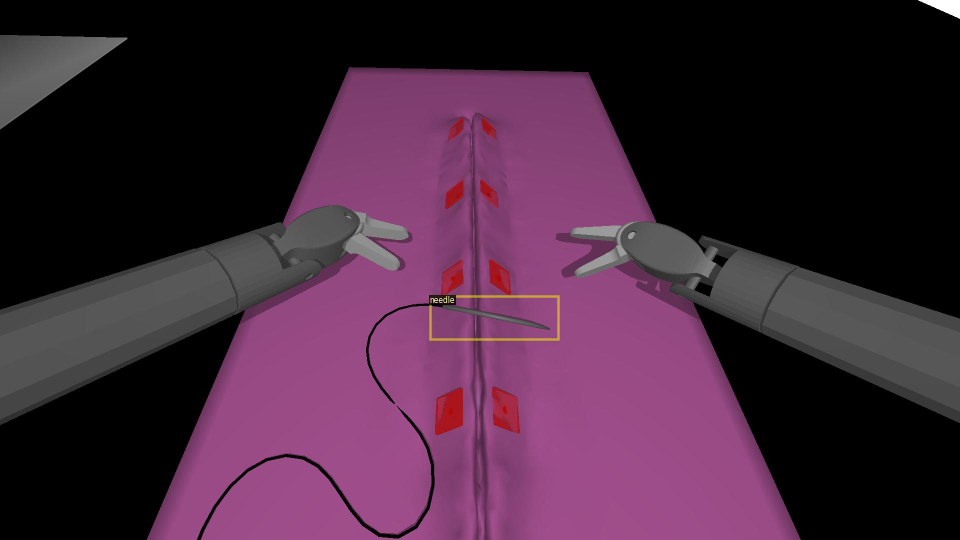

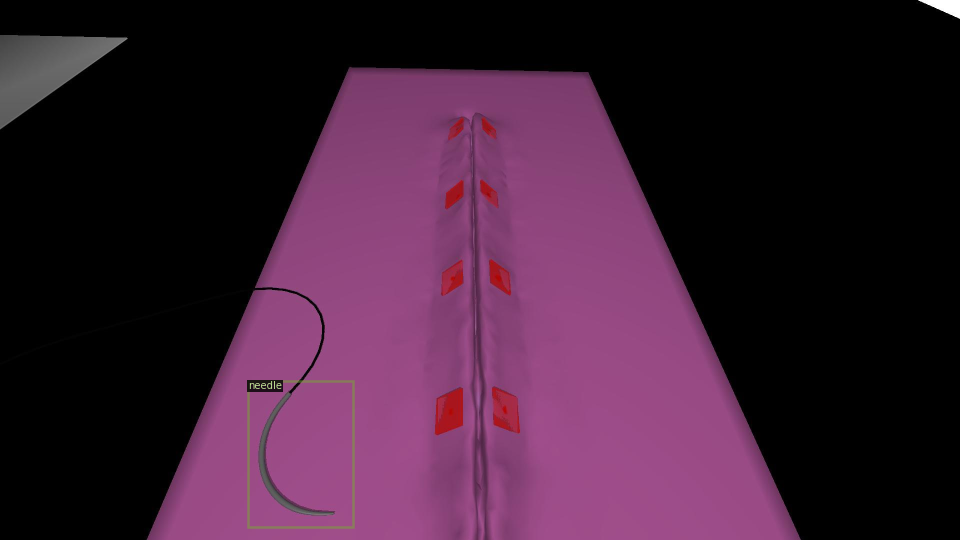

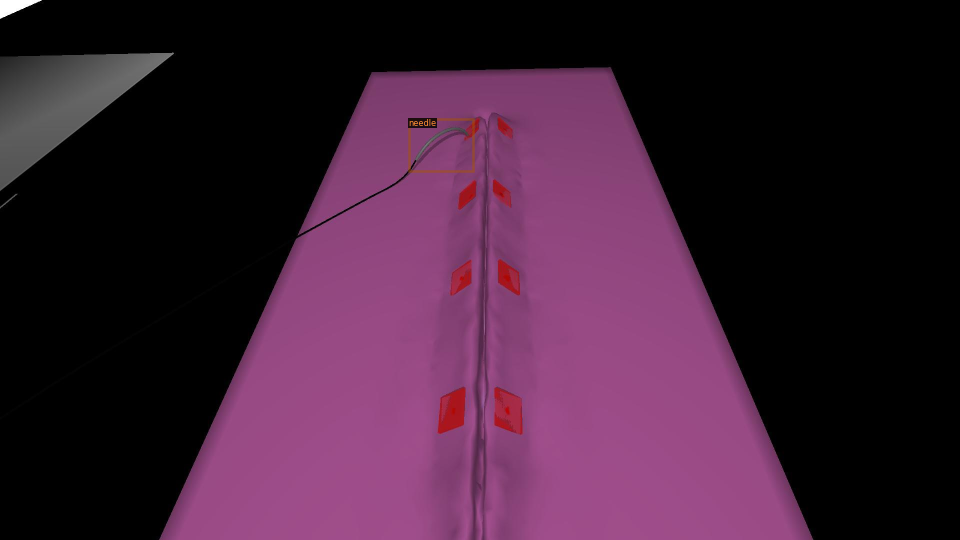

In [ ]:
# This will pull a random 3 jpg files from the training dataset to validate a 
# successful importation of the roboflow dataset.
my_dataset_train_metadata = MetadataCatalog.get("my_dataset_train")
dataset_dicts = DatasetCatalog.get("my_dataset_train")

import random
from detectron2.utils.visualizer import Visualizer

for d in random.sample(dataset_dicts, 3):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=my_dataset_train_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])



# Training the Detectron2 algorithm on the Roboflow DS

In [ ]:
# This will utilize our own Trainer Module here as to use the COCO validation 
# evaluation during training. If this were not to be done then no validation 
# eval would occur.

from detectron2.engine import DefaultTrainer
from detectron2.evaluation import COCOEvaluator

class CocoTrainer(DefaultTrainer):

  @classmethod
  def build_evaluator(cls, cfg, dataset_name, output_folder=None):

    if output_folder is None:
        os.makedirs("coco_eval", exist_ok=True)
        output_folder = "coco_eval"

    return COCOEvaluator(dataset_name, cfg, False, output_folder)

In [ ]:
# This portion of the code is the innerworkings of the COCO evaluation. This 
# trains the ds of Detectron2. The wait time for this is about an hour and the 
# GPU clocks in at around 50% of its total capacity once this process is 
# initialized through CUDA.
from detectron2.config import get_cfg
import os

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("my_dataset_train",)
cfg.DATASETS.TEST = ("my_dataset_val",)
cfg.DATALOADER.NUM_WORKERS = 1 
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_X_101_32x8d_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 1 
cfg.SOLVER.BASE_LR = 0.001 
cfg.SOLVER.WARMUP_ITERS = 1000
cfg.SOLVER.MAX_ITER = 1500 
cfg.SOLVER.STEPS = (1000, 1500)
cfg.SOLVER.GAMMA = 0.05
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 64
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 2 
cfg.TEST.EVAL_PERIOD = 500


os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = CocoTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[04/28 02:29:49 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_68b088.pkl: 421MB [00:06, 60.9MB/s]                           
Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (3, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (3,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (8, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (8,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_pre

[04/28 02:30:01 d2.engine.train_loop]: Starting training from iteration 0
[04/28 02:30:46 d2.utils.events]:  eta: 0:54:23  iter: 19  total_loss: 1.286  loss_cls: 0.963  loss_box_reg: 0.195  loss_rpn_cls: 0.089  loss_rpn_loc: 0.004  time: 2.2149  data_time: 0.0144  lr: 0.000020  max_mem: 3653M
[04/28 02:31:32 d2.utils.events]:  eta: 0:56:18  iter: 39  total_loss: 1.147  loss_cls: 0.625  loss_box_reg: 0.285  loss_rpn_cls: 0.095  loss_rpn_loc: 0.008  time: 2.2590  data_time: 0.0037  lr: 0.000040  max_mem: 3653M
[04/28 02:32:17 d2.utils.events]:  eta: 0:55:50  iter: 59  total_loss: 1.362  loss_cls: 0.548  loss_box_reg: 0.742  loss_rpn_cls: 0.041  loss_rpn_loc: 0.007  time: 2.2546  data_time: 0.0039  lr: 0.000060  max_mem: 3653M
[04/28 02:33:03 d2.utils.events]:  eta: 0:55:33  iter: 79  total_loss: 1.385  loss_cls: 0.429  loss_box_reg: 0.913  loss_rpn_cls: 0.004  loss_rpn_loc: 0.005  time: 2.2642  data_time: 0.0037  lr: 0.000080  max_mem: 3653M
[04/28 02:33:48 d2.utils.events]:  eta: 0:54:4

In [ ]:
# This gives us the visualization of the training curves in tensorboard (eg. loss, time, total loss, etc.)
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
# This then runs a test evaluation with the trained model
from detectron2.data import DatasetCatalog, MetadataCatalog, build_detection_test_loader
from detectron2.evaluation import COCOEvaluator, inference_on_dataset

cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.85
predictor = DefaultPredictor(cfg)
evaluator = COCOEvaluator("my_dataset_test", cfg, False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "my_dataset_test")
inference_on_dataset(trainer.model, val_loader, evaluator)

WARNING [04/28 03:29:04 d2.data.datasets.coco]: 
Category ids in annotations are not in [1, #categories]! We'll apply a mapping for you.

[04/28 03:29:04 d2.data.datasets.coco]: Loaded 46 images in COCO format from /content/test/_annotations.coco.json
[04/28 03:29:04 d2.data.build]: Distribution of instances among all 2 categories:
|  category  | #instances   |  category  | #instances   |
|:----------:|:-------------|:----------:|:-------------|
|   needle   | 0            |   needle   | 46           |
|            |              |            |              |
|   total    | 46           |            |              |
[04/28 03:29:04 d2.data.common]: Serializing 46 elements to byte tensors and concatenating them all ...
[04/28 03:29:04 d2.data.common]: Serialized dataset takes 0.01 MiB
[04/28 03:29:04 d2.evaluation.evaluator]: Start inference on 46 images
[04/28 03:29:13 d2.evaluation.evaluator]: Inference done 11/46. 0.8116 s / img. ETA=0:00:28
[04/28 03:29:19 d2.evaluation.evaluator]: 

OrderedDict([('bbox',
              {'AP': 75.31889608040385,
               'AP-needle': 75.31889608040385,
               'AP50': 95.39388721480844,
               'AP75': 88.42014636246235,
               'APl': 74.73645396527593,
               'APm': 92.52475247524752,
               'APs': nan})])

# Prediction with the trained Detectron2 Algorithm





In [ ]:
# Confirmation of successful training and results
%ls ./output/

coco_instances_results.json                       last_checkpoint
events.out.tfevents.1651112994.cf64b621c786.71.0  metrics.json
instances_predictions.pth                         model_final.pth


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.DATASETS.TEST = ("my_dataset_test", )
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.7 
predictor = DefaultPredictor(cfg)
test_metadata = MetadataCatalog.get("my_dataset_test")

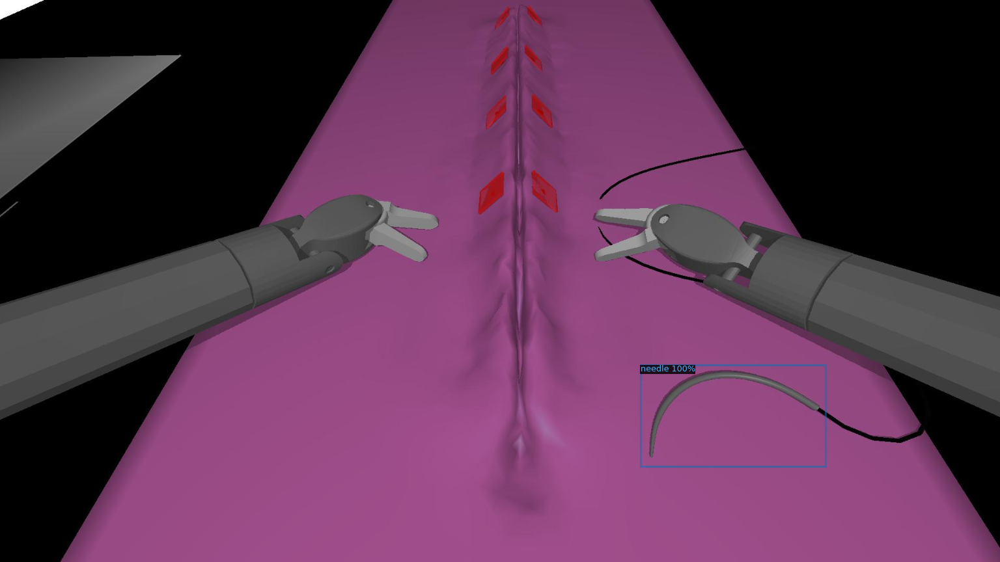

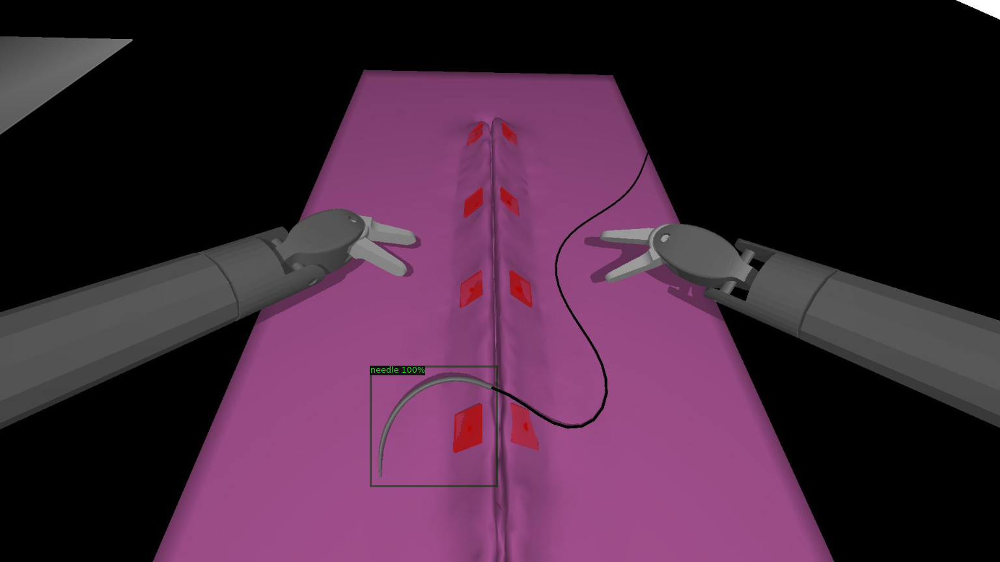

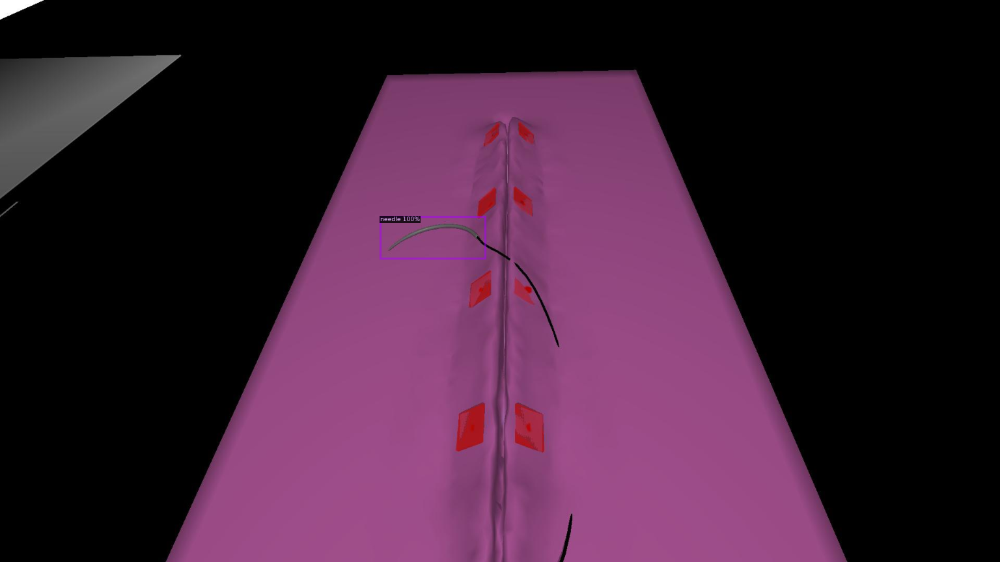

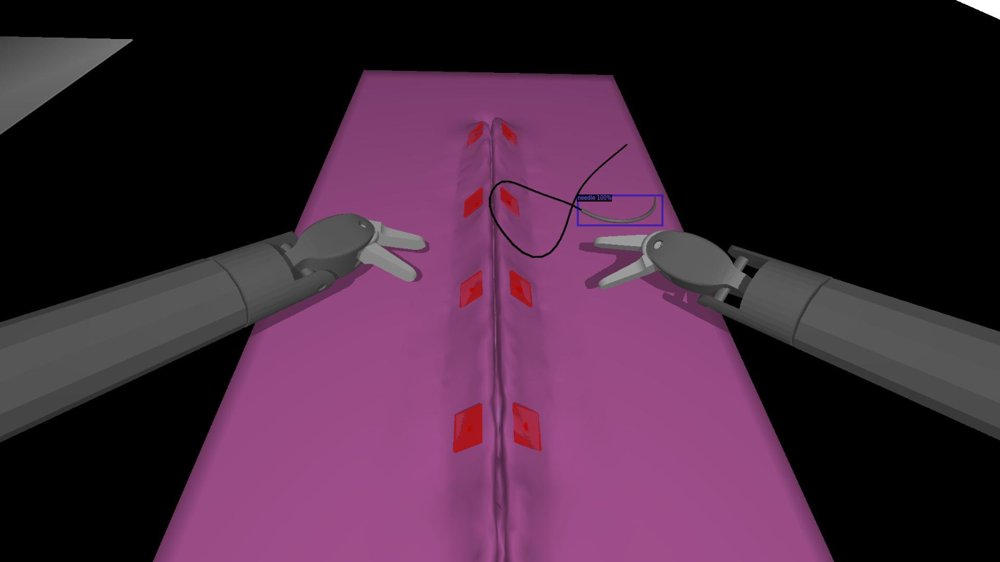

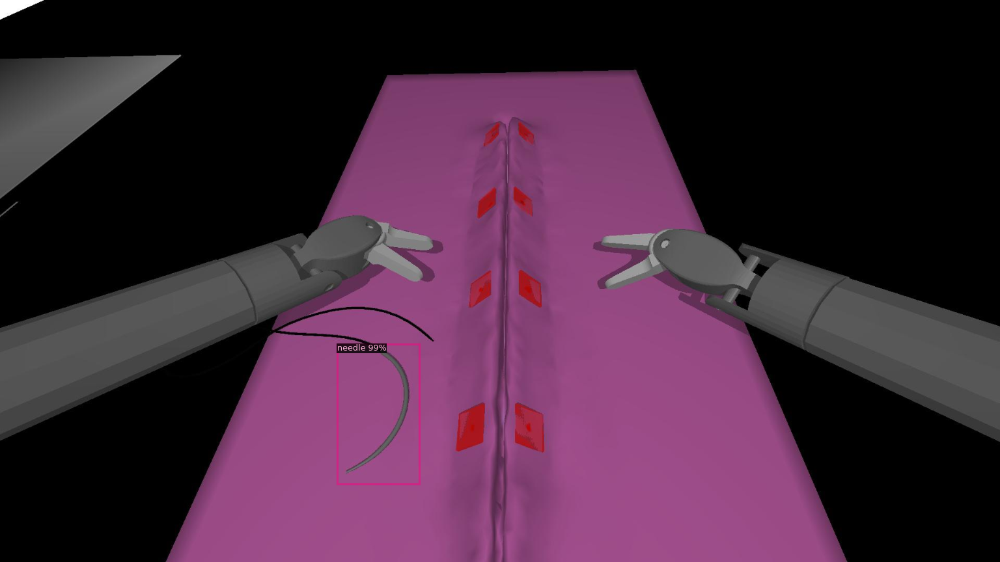

...

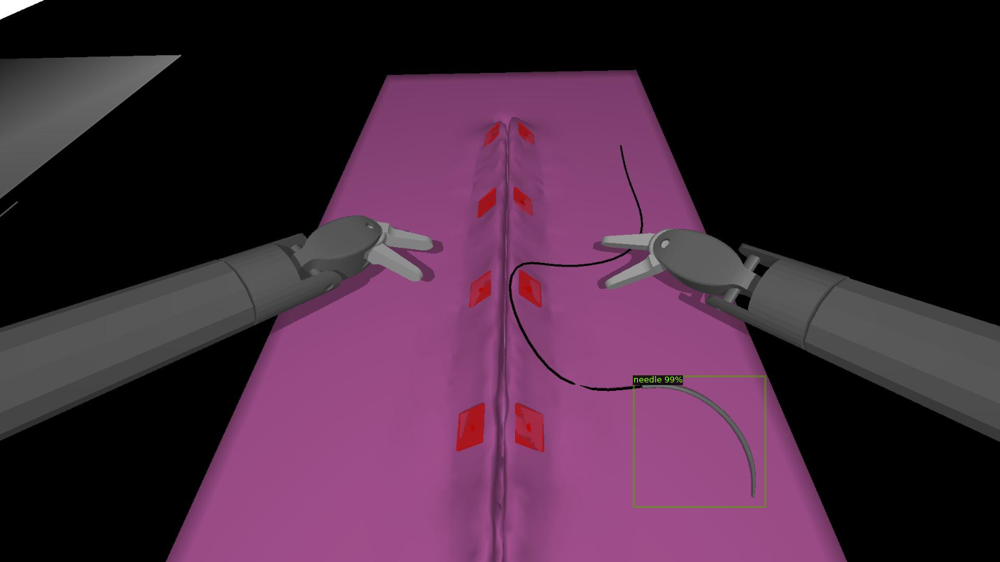

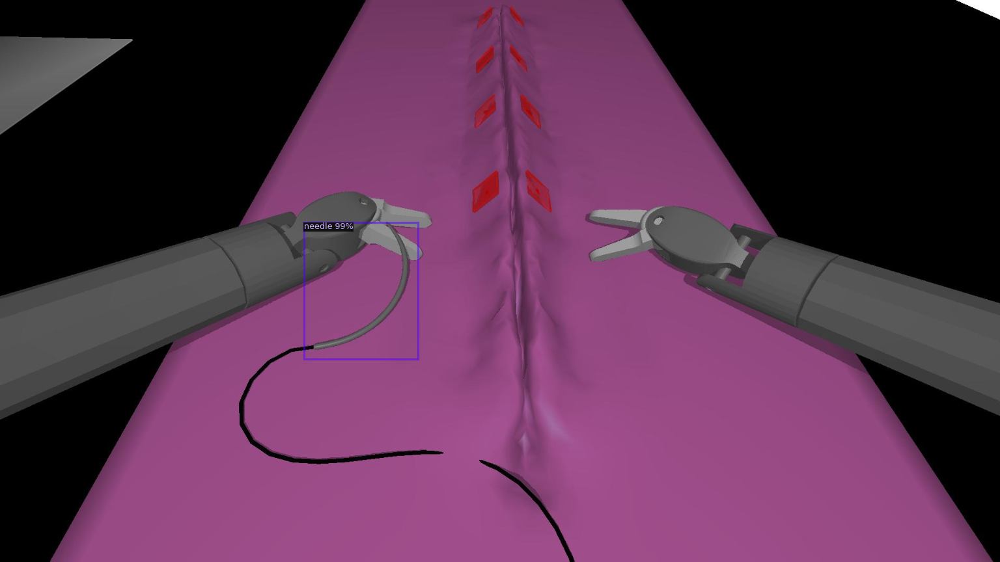

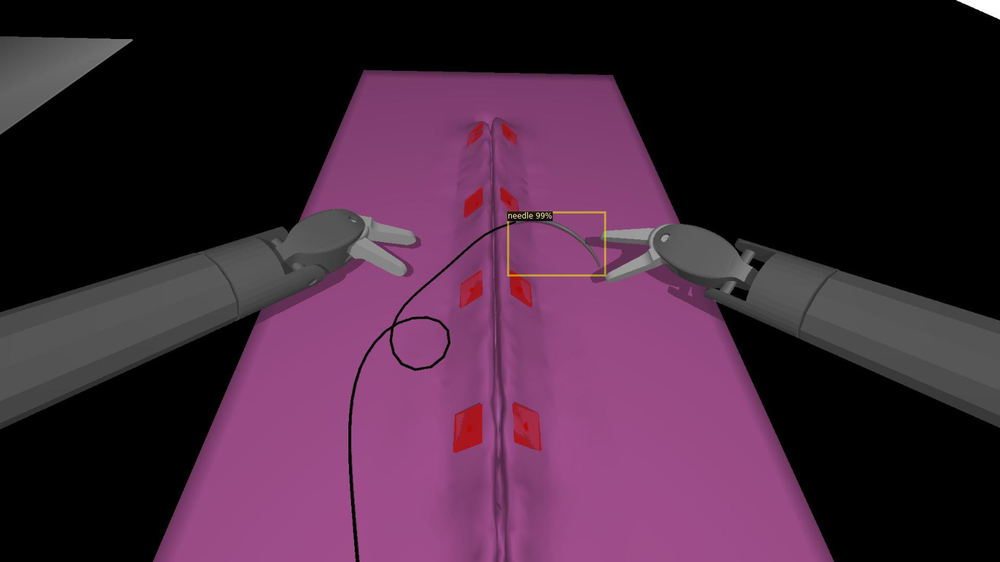

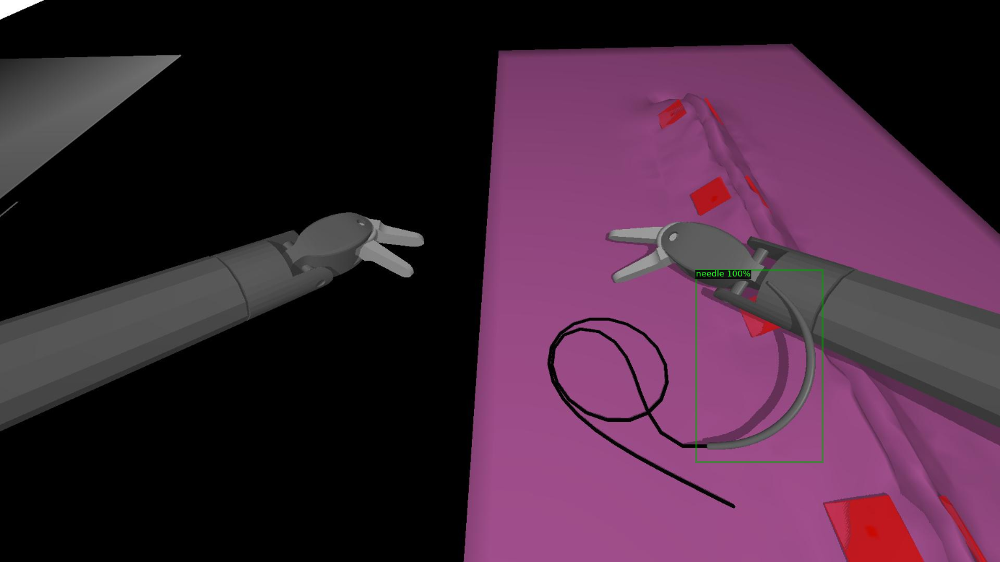

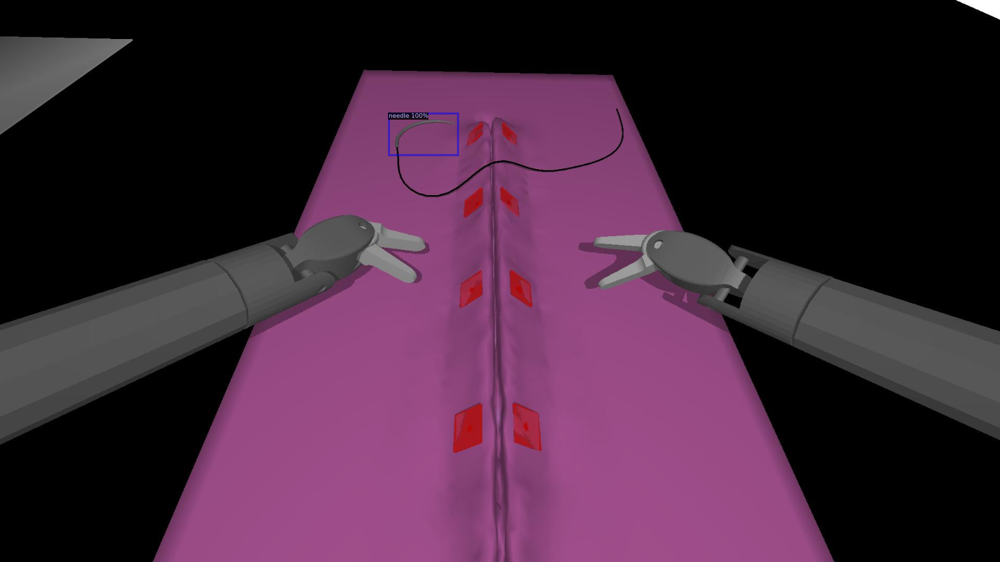

In [ ]:
# Shows the predictions of the trained DS within the test folder from Roboflow.
# Results from this illustrate a detection accuracy of 98%-100%.
from detectron2.utils.visualizer import ColorMode
import glob

for imageName in glob.glob('/content/test/*jpg'):
  im = cv2.imread(imageName)
  outputs = predictor(im)
  v = Visualizer(im[:, :, ::-1],
                metadata=test_metadata, 
                scale=0.8
                 )
  out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(out.get_image()[:, :, ::-1])


# Install the Mesh-RCNN Dependencies


In [1]:
# This is the code to clone and initialize the Mesh-RCNN Library
!pip install -U 'git+https://github.com/facebookresearch/meshrcnn.git'

%cd /usr/local/lib/python3.7/dist-packages/meshrcnn-1.0.dist-info
!pip install -e /usr/local/lib/python3.7/dist-packages/meshrcnn-1.0.dist-info

  Cloning https://github.com/facebookresearch/meshrcnn.git to /tmp/pip-req-build-h3tth51l
  Running command git clone -q https://github.com/facebookresearch/meshrcnn.git /tmp/pip-req-build-h3tth51l
     |████████████████████████████████| 50 kB 2.8 MB/s 
ERROR: Could not find a version that satisfies the requirement detectron2 (from meshrcnn) (from versions: none)
ERROR: No matching distribution found for detectron2
[Errno 2] No such file or directory: '/usr/local/lib/python3.7/dist-packages/meshrcnn-1.0.dist-info'
/content
ERROR: /usr/local/lib/python3.7/dist-packages/meshrcnn-1.0.dist-info is not a valid editable requirement. It should either be a path to a local project or a VCS URL (beginning with bzr+http, bzr+https, bzr+ssh, bzr+sftp, bzr+ftp, bzr+lp, bzr+file, git+http, git+https, git+ssh, git+git, git+file, hg+file, hg+http, hg+https, hg+ssh, hg+static-http, svn+ssh, svn+http, svn+https, svn+svn, svn+file).


# Beginning "Cubification" of 2D Detection to create Voxel Mesh

In [ ]:
# *******Reference Code******

#!/usr/bin/env python3
# -*- coding: utf-8 -*-
# Copyright (c) Facebook, Inc. and its affiliates. All Rights Reserved
import argparse
import logging
import multiprocessing as mp
import numpy as np
import os
import torch
from detectron2.config import get_cfg
from detectron2.data import MetadataCatalog
from detectron2.data.detection_utils import read_image
from detectron2.engine.defaults import DefaultPredictor
from detectron2.utils.logger import setup_logger
from pytorch3d.io import save_obj
from pytorch3d.structures import Meshes

# required so that .register() calls are executed in module scope
import meshrcnn.data  # noqa
import meshrcnn.modeling  # noqa
import meshrcnn.utils  # noqa
from meshrcnn.config import get_meshrcnn_cfg_defaults
from meshrcnn.evaluation import transform_meshes_to_camera_coord_system

import cv2

logger = logging.getLogger("demo")


class VisualizationDemo(object):
    def __init__(self, cfg, vis_highest_scoring=True, output_dir="./vis"):
        """
        Args:
            cfg (CfgNode):
            vis_highest_scoring (bool): If set to True visualizes only
                                        the highest scoring prediction
        """
        self.metadata = MetadataCatalog.get(cfg.DATASETS.TEST[0])
        self.colors = self.metadata.thing_colors
        self.cat_names = self.metadata.thing_classes

        self.cpu_device = torch.device("cpu")
        self.vis_highest_scoring = vis_highest_scoring
        self.predictor = DefaultPredictor(cfg)

        os.makedirs(output_dir, exist_ok=True)
        self.output_dir = output_dir

    def run_on_image(self, image, focal_length=10.0):
        """
        Args:
            image (np.ndarray): an image of shape (H, W, C) (in BGR order).
                This is the format used by OpenCV.
            focal_length (float): the focal_length of the image
        Returns:
            predictions (dict): the output of the model.
        """
        predictions = self.predictor(image)
        # Convert image from OpenCV BGR format to Matplotlib RGB format.
        image = image[:, :, ::-1]

        # camera matrix
        imsize = [image.shape[0], image.shape[1]]
        # focal <- focal * image_width / 32
        focal_length = image.shape[1] / 32 * focal_length
        K = [focal_length, image.shape[1] / 2, image.shape[0] / 2]

        if "instances" in predictions:
            instances = predictions["instances"].to(self.cpu_device)
            scores = instances.scores
            boxes = instances.pred_boxes
            labels = instances.pred_classes
            masks = instances.pred_masks
            meshes = Meshes(
                verts=[mesh[0] for mesh in instances.pred_meshes],
                faces=[mesh[1] for mesh in instances.pred_meshes],
            )
            pred_dz = instances.pred_dz[:, 0] * (boxes.tensor[:, 3] - boxes.tensor[:, 1])
            tc = pred_dz.abs().max() + 1.0
            zranges = torch.stack(
                [
                    torch.stack(
                        [
                            tc - tc * pred_dz[i] / 2.0 / focal_length,
                            tc + tc * pred_dz[i] / 2.0 / focal_length,
                        ]
                    )
                    for i in range(len(meshes))
                ],
                dim=0,
            )

            Ks = torch.tensor(K).to(self.cpu_device).view(1, 3).expand(len(meshes), 3)
            meshes = transform_meshes_to_camera_coord_system(
                meshes, boxes.tensor, zranges, Ks, imsize
            )

            if self.vis_highest_scoring:
                det_ids = [scores.argmax().item()]
            else:
                det_ids = range(len(scores))

            for det_id in det_ids:
                self.visualize_prediction(
                    det_id,
                    image,
                    boxes.tensor[det_id],
                    labels[det_id],
                    scores[det_id],
                    masks[det_id],
                    meshes[det_id],
                )

        return predictions

    def visualize_prediction(
        self, det_id, image, box, label, score, mask, mesh, alpha=0.6, dpi=200
    ):

        mask_color = np.array(self.colors[label], dtype=np.float32)
        cat_name = self.cat_names[label]
        thickness = max([int(np.ceil(0.001 * image.shape[0])), 1])
        box_color = (0, 255, 0)  # '#00ff00', green
        text_color = (218, 227, 218)  # gray

        composite = image.copy().astype(np.float32)

        # overlay mask
        idx = mask.nonzero()
        composite[idx[:, 0], idx[:, 1], :] *= 1.0 - alpha
        composite[idx[:, 0], idx[:, 1], :] += alpha * mask_color

        # overlay box
        (x0, y0, x1, y1) = (int(x + 0.5) for x in box)
        composite = cv2.rectangle(
            composite, (x0, y0), (x1, y1), color=box_color, thickness=thickness
        )
        composite = composite.astype(np.uint8)

        # overlay text
        font_scale = 0.001 * image.shape[0]
        font_thickness = thickness
        font = cv2.FONT_HERSHEY_TRIPLEX
        text = "%s %.3f" % (cat_name, score)
        ((text_w, text_h), _) = cv2.getTextSize(text, font, font_scale, font_thickness)
        # Place text background.
        if x0 + text_w > composite.shape[1]:
            x0 = composite.shape[1] - text_w
        if y0 - int(1.2 * text_h) < 0:
            y0 = int(1.2 * text_h)
        back_topleft = x0, y0 - int(1.3 * text_h)
        back_bottomright = x0 + text_w, y0
        cv2.rectangle(composite, back_topleft, back_bottomright, box_color, -1)
        # Show text
        text_bottomleft = x0, y0 - int(0.2 * text_h)
        cv2.putText(
            composite,
            text,
            text_bottomleft,
            font,
            font_scale,
            text_color,
            thickness=font_thickness,
            lineType=cv2.LINE_AA,
        )

        save_file = os.path.join(self.output_dir, "%d_mask_%s_%.3f.png" % (det_id, cat_name, score))
        cv2.imwrite(save_file, composite[:, :, ::-1])

        save_file = os.path.join(self.output_dir, "%d_mesh_%s_%.3f.obj" % (det_id, cat_name, score))
        verts, faces = mesh.get_mesh_verts_faces(0)
        save_obj(save_file, verts, faces)


def setup_cfg(args):
    cfg = get_cfg()
    get_meshrcnn_cfg_defaults(cfg)
    cfg.merge_from_file(args.config_file)
    cfg.merge_from_list(args.opts)
    cfg.freeze()
    return cfg


def get_parser():
    parser = argparse.ArgumentParser(description="MeshRCNN Demo")
    parser.add_argument(
        "--config-file",
        default="configs/pix3d/meshrcnn_R50_FPN.yaml",
        metavar="FILE",
        help="path to config file",
    )
    parser.add_argument("--input", help="A path to an input image")
    parser.add_argument("--output", help="A directory to save output visualizations")
    parser.add_argument(
        "--focal-length", type=float, default=20.0, help="Focal length for the image"
    )
    parser.add_argument(
        "--onlyhighest", action="store_true", help="will return only the highest scoring detection"
    )

    parser.add_argument(
        "opts",
        help="Modify model config options using the command-line",
        default=None,
        nargs=argparse.REMAINDER,
    )
    return parser


if __name__ == "__main__":
    mp.set_start_method("spawn", force=True)
    args = get_parser().parse_args()
    logger = setup_logger(name="demo")
    logger.info("Arguments: " + str(args))

    cfg = setup_cfg(args)

    im_name = args.input.split("/")[-1].split(".")[0]

    demo = VisualizationDemo(
        cfg, vis_highest_scoring=args.onlyhighest, output_dir=os.path.join(args.output, im_name)
    )

    # use PIL, to be consistent with evaluation
    img = read_image(args.input, format="BGR")
    predictions = demo.run_on_image(img, focal_length=args.focal_length)
    logger.info("Predictions saved in %s" % (os.path.join(args.output, im_name)))

ImportError: ignored